## Title: Analyzing the Intersection of Individual Earnings, Education Duration, and Age Factors
### Introduction:
Income plays an increasingly important role in modern society and is closely linked to people's health,  stress,  living conditions, and quality of life. Thus, analysis of the relationship between demographic data and income is of great significance. The topic that we chose to analyze is whether an individual’s demographic influences their yearly income.  To be more specific, when considering factors that influence income, the level of education and age becomes an indispensable aspect. While educational attainment is associated with many variables, it is undeniable that there is a notable, complex, and nuanced interplay between age, educational level and income. For instance, a study conducted in the UK showed that parental education, especially maternal education, has a significant impact on children's educational choices and outcomes (Chevalier, et al., 1). More specifically, literature has shown that there are significant impacts of education, both in terms of the quantity of education (years of schooling) and the quality (educational degree), as well as age, on income levels (Chen, et al., 416). This trend has been found in different places around the world. For example, a study conducted in Saudi Arabia concludes that education qualification and the sector (public or private) are the most significant factors affecting Saudi salaries. The study highlights that individuals with higher education levels, such as a doctoral degree, and specific work experience, tend to have higher incomes​ (Alsulami, 129).  These studies demonstrated that a more in-depth exploration of the relationship between these factors is valuable. In our dataset, the level of education is quantified by the number of years of education received and age in years.
The question we are proposing to investigate is how years of education, in conjunction with age, influence the likelihood of an individual earning above or below 50k a year. We aim to build a classifier that could be used in real life to predict whether an individual's  income level is above or below 50k per year based on education years and age. The dataset that we chose is called “Census Income,” and this dataset was created in 1996. The dataset lists off a selection of individuals alongside their age,  sex, years of education and other characteristics and in the last column, states whether they make above or below 50k a year. 


In [1]:
library(tidyverse)
library(tidymodels)
library(repr)
library(readxl)
install.packages("kknn")
library(kknn)

── Attaching packages ─────────────────────────────────────── tidyverse 1.3.2 ──
✔ ggplot2 3.4.2     ✔ purrr   1.0.1
✔ tibble  3.2.1     ✔ dplyr   1.1.1
✔ tidyr   1.3.0     ✔ stringr 1.5.0
✔ readr   2.1.3     ✔ forcats 0.5.2
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
── Attaching packages ────────────────────────────────────── tidymodels 1.0.0 ──

✔ broom        1.0.2     ✔ rsample      1.1.1
✔ dials        1.1.0     ✔ tune         1.0.1
✔ infer        1.0.4     ✔ workflows    1.1.2
✔ modeldata    1.0.1     ✔ workflowsets 1.0.0
✔ parsnip      1.0.3     ✔ yardstick    1.1.0
✔ recipes      1.0.4     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filter()   masks stats::filter()
✖ recipes::fixed()  masks stringr::fixed()
✖ dplyr::lag()      masks stats::lag()
✖ yardstick::spec() masks read

### Loads data from the original source and create readable names for each column.
#### Show only first 5 line and last 5 line of the data set.

In [2]:
url <- "https://raw.githubusercontent.com/Junz0808/DSCI_Project_Group31/main/Census_income/adult.data"

In [3]:
Census_income <- read_csv(url, col_names = 
                          c("age", "workclass","fnlwgt","education","education_num","marital_status",
                            "occupation","relationship","race","sex","capital_gain","capital_loss",
                            "hours_per_week","native_country", "income_lvl"))
glimpse(Census_income)
head(Census_income)

Rows: 32561 Columns: 15
── Column specification ────────────────────────────────────────────────────────
Delimiter: ","
chr (9): workclass, education, marital_status, occupation, relationship, rac...
dbl (6): age, fnlwgt, education_num, capital_gain, capital_loss, hours_per_week

ℹ Use `spec()` to retrieve the full column specification for this data.
ℹ Specify the column types or set `show_col_types = FALSE` to quiet this message.


Rows: 32,561
Columns: 15
$ age            <dbl> 39, 50, 38, 53, 28, 37, 49, 52, 31, 42, 37, 30, 23, 32,…
$ workclass      <chr> "State-gov", "Self-emp-not-inc", "Private", "Private", …
$ fnlwgt         <dbl> 77516, 83311, 215646, 234721, 338409, 284582, 160187, 2…
$ education      <chr> "Bachelors", "Bachelors", "HS-grad", "11th", "Bachelors…
$ education_num  <dbl> 13, 13, 9, 7, 13, 14, 5, 9, 14, 13, 10, 13, 13, 12, 11,…
$ marital_status <chr> "Never-married", "Married-civ-spouse", "Divorced", "Mar…
$ occupation     <chr> "Adm-clerical", "Exec-managerial", "Handlers-cleaners",…
$ relationship   <chr> "Not-in-family", "Husband", "Not-in-family", "Husband",…
$ race           <chr> "White", "White", "White", "Black", "Black", "White", "…
$ sex            <chr> "Male", "Male", "Male", "Male", "Female", "Female", "Fe…
$ capital_gain   <dbl> 2174, 0, 0, 0, 0, 0, 0, 0, 14084, 5178, 0, 0, 0, 0, 0, …
$ capital_loss   <dbl> 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0…
$ hours_per_wee

age,workclass,fnlwgt,education,education_num,marital_status,occupation,relationship,race,sex,capital_gain,capital_loss,hours_per_week,native_country,income_lvl
<dbl>,<chr>,<dbl>,<chr>,<dbl>,<chr>,<chr>,<chr>,<chr>,<chr>,<dbl>,<dbl>,<dbl>,<chr>,<chr>
39,State-gov,77516,Bachelors,13,Never-married,Adm-clerical,Not-in-family,White,Male,2174,0,40,United-States,<=50K
50,Self-emp-not-inc,83311,Bachelors,13,Married-civ-spouse,Exec-managerial,Husband,White,Male,0,0,13,United-States,<=50K
38,Private,215646,HS-grad,9,Divorced,Handlers-cleaners,Not-in-family,White,Male,0,0,40,United-States,<=50K
53,Private,234721,11th,7,Married-civ-spouse,Handlers-cleaners,Husband,Black,Male,0,0,40,United-States,<=50K
28,Private,338409,Bachelors,13,Married-civ-spouse,Prof-specialty,Wife,Black,Female,0,0,40,Cuba,<=50K
37,Private,284582,Masters,14,Married-civ-spouse,Exec-managerial,Wife,White,Female,0,0,40,United-States,<=50K


In [4]:
Census_income_filtered <- select(Census_income,age,education_num,income_lvl)
head(Census_income_filtered)

age,education_num,income_lvl
<dbl>,<dbl>,<chr>
39,13,<=50K
50,13,<=50K
38,9,<=50K
53,7,<=50K
28,13,<=50K
37,14,<=50K


### Using Jitter function to get a better visualizing scattor plot before the data is scaled.

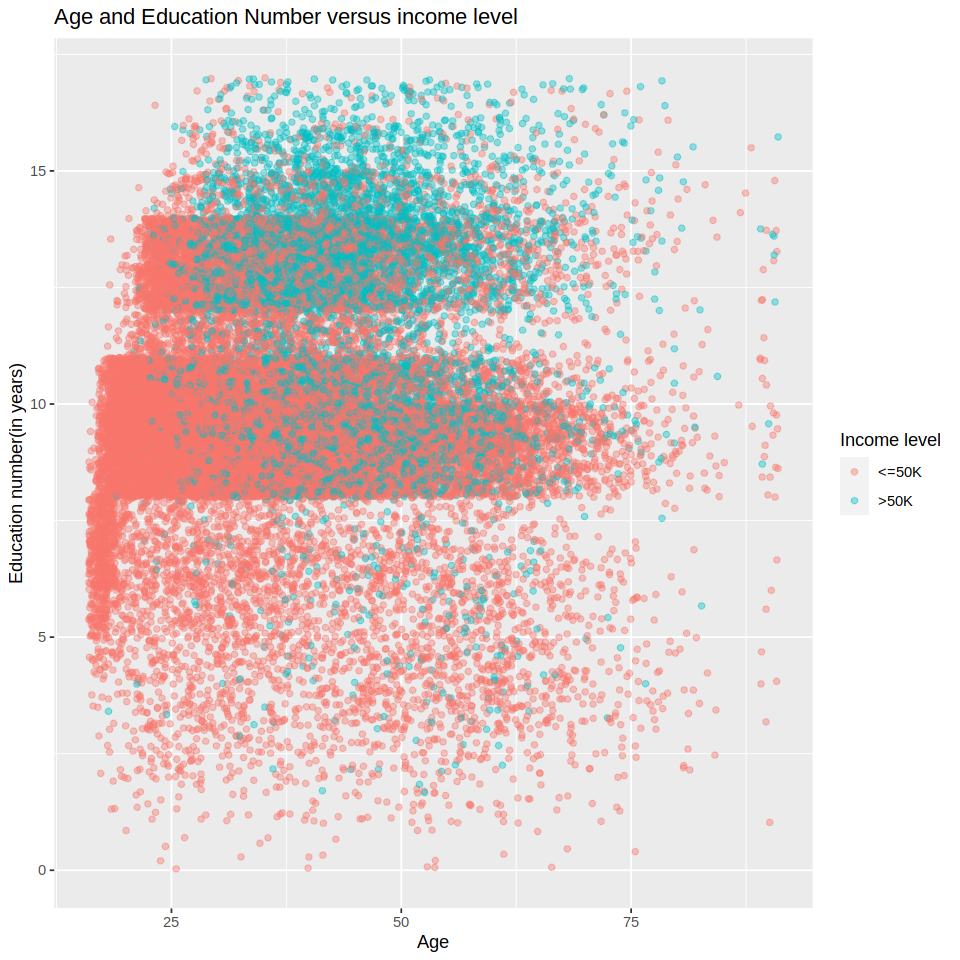

In [5]:
options(repr.plot.width = 8, repr.plot.height = 8) 

Census_income_plot <- Census_income_filtered|>
                      ggplot(aes(x = age, y = education_num, colour = income_lvl)) + 
                      geom_jitter(alpha = 0.4, width = 1, height = 1) + 
                      labs(title = "Age and Education Number versus income level", x = "Age", y = "Education number(in years)", colour = "Income level")

Census_income_plot

### Wrangles and cleans the data from it's original (downloaded) format to the format necessary for the planned analysis
#### Filter the columns that we only interested in.

In [6]:
Census_income_filtered <- Census_income_filtered |>
                          mutate(income_lvl = as_factor(income_lvl)) |>
                          mutate(income_lvl = fct_recode(income_lvl,  "Less_or_equal_to_50K" = "<=50K", "More_than_50K" = ">50K"))
head(Census_income_filtered)

age,education_num,income_lvl
<dbl>,<dbl>,<fct>
39,13,Less_or_equal_to_50K
50,13,Less_or_equal_to_50K
38,9,Less_or_equal_to_50K
53,7,Less_or_equal_to_50K
28,13,Less_or_equal_to_50K
37,14,Less_or_equal_to_50K


#### Show the ratio of the response variable

In [7]:
num_obs <- nrow(Census_income_filtered)
           Census_income_filtered |>
           group_by(income_lvl) |>
           summarize(count = n(),percentage = n() / num_obs * 100)

income_lvl,count,percentage
<fct>,<int>,<dbl>
Less_or_equal_to_50K,24720,75.91904
More_than_50K,7841,24.08096


#### Split the data into 75% and 25% into traning data and testing data.

In [8]:
set.seed(9999) 
Census_income_split <- initial_split(Census_income_filtered, prop = 0.75, strata = income_lvl)  
Census_income_train <- training(Census_income_split)   
Census_income_test <- testing(Census_income_split)

head(Census_income_train)
head(Census_income_test)

age,education_num,income_lvl
<dbl>,<dbl>,<fct>
53,7,Less_or_equal_to_50K
37,14,Less_or_equal_to_50K
49,5,Less_or_equal_to_50K
23,13,Less_or_equal_to_50K
32,12,Less_or_equal_to_50K
34,4,Less_or_equal_to_50K


age,education_num,income_lvl
<dbl>,<dbl>,<fct>
39,13,Less_or_equal_to_50K
50,13,Less_or_equal_to_50K
38,9,Less_or_equal_to_50K
28,13,Less_or_equal_to_50K
40,11,More_than_50K
38,7,Less_or_equal_to_50K


#### Create a recipe and scale the training data 

In [9]:
set.seed(9999) 
Census_income_recipe <- recipe(income_lvl ~ age + education_num, data = Census_income_train) |>
                        step_scale(all_predictors()) |>
                        step_center(all_predictors())|>
                        prep()
Census_income_recipe
income_data_scaled <- Census_income_recipe |>   
                            bake(Census_income_train)

head(income_data_scaled)

Recipe

Inputs:

      role #variables
   outcome          1
 predictor          2

Training data contained 24420 data points and no missing data.

Operations:

Scaling for age, education_num [trained]
Centering for age, education_num [trained]

age,education_num,income_lvl
<dbl>,<dbl>,<fct>
1.0563237,-1.2027162,Less_or_equal_to_50K
-0.1151473,1.5179103,Less_or_equal_to_50K
0.7634560,-1.9800381,Less_or_equal_to_50K
-1.1401844,1.1292494,Less_or_equal_to_50K
-0.4812320,0.7405885,Less_or_equal_to_50K
-0.3347981,-2.3686990,Less_or_equal_to_50K


### Creates a visualization of the dataset that is relevant for exploratory data analysis related to the planned analysis

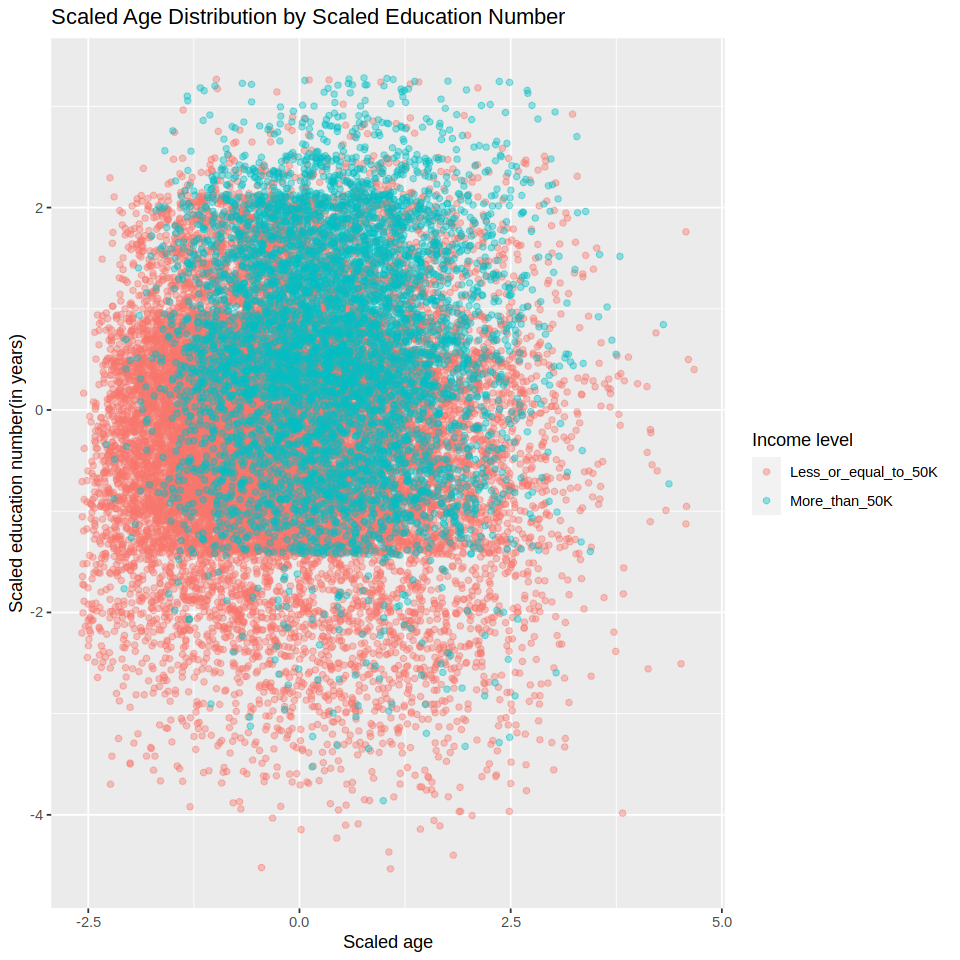

In [10]:
options(repr.plot.width = 8, repr.plot.height = 8) 

income_scaled_plot <- income_data_scaled|>
                      ggplot(aes(x = age, y = education_num, colour = income_lvl)) + 
                      geom_jitter(alpha = 0.4, width = 1, height = 1) + 
                      labs(title = "Scaled Age Distribution by Scaled Education Number", x = "Scaled age", y = "Scaled education number(in years)", colour = "Income level")

income_scaled_plot

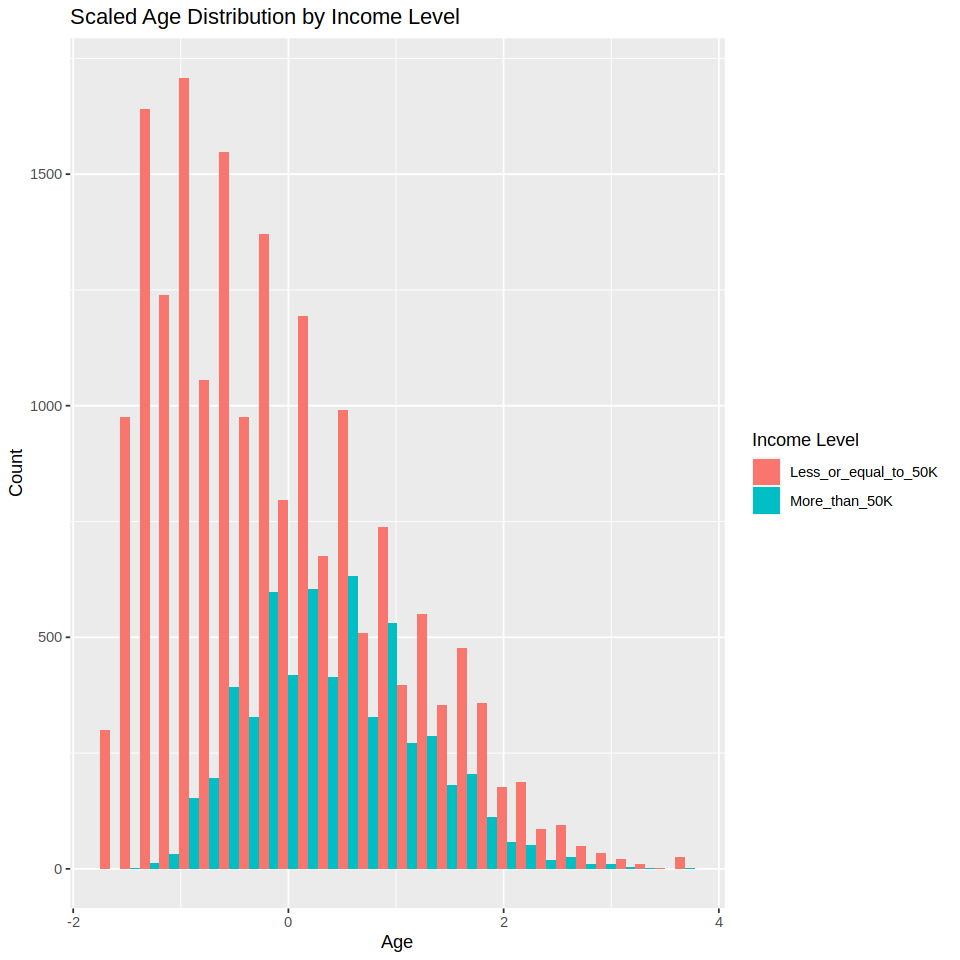

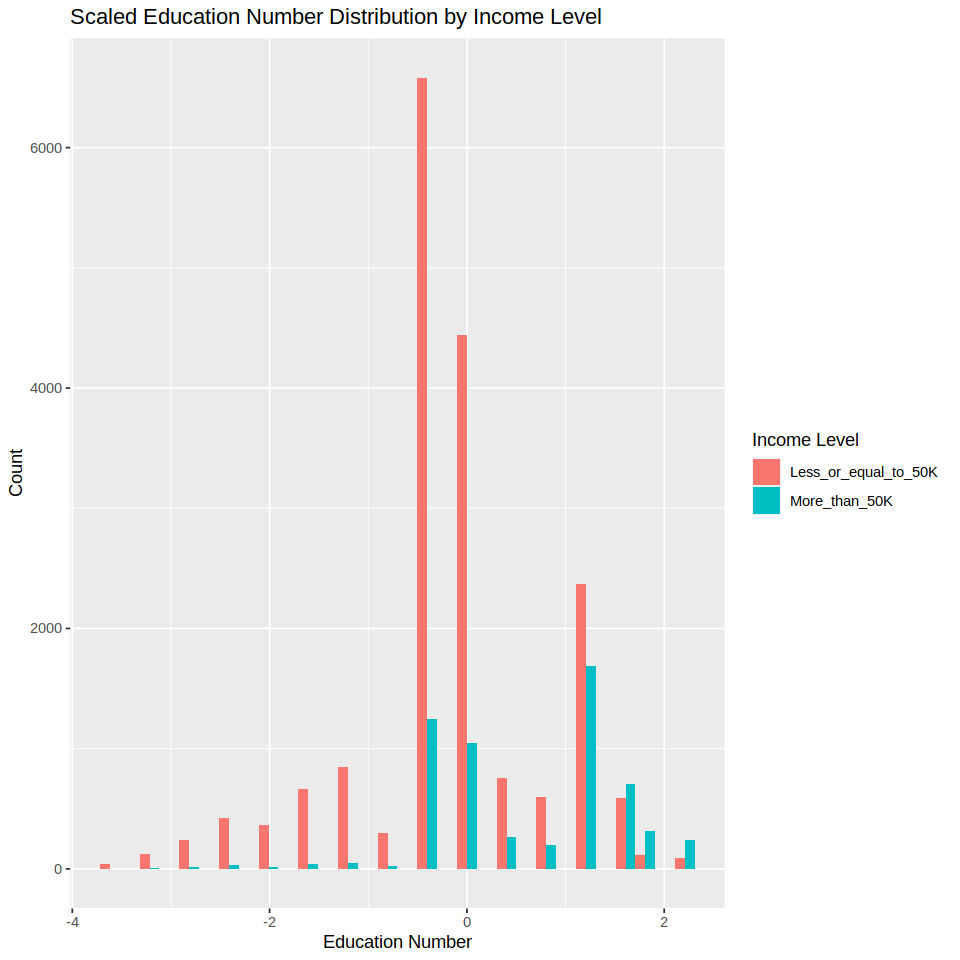

In [11]:
options(repr.plot.width = 8, repr.plot.height = 8) 

age_plot <- ggplot(income_data_scaled, aes(x = age, fill = income_lvl)) +
            geom_histogram(position = "dodge", bins = 30) +
            labs(title = "Scaled Age Distribution by Income Level", x = "Age", y = "Count", fill = "Income Level")
 


edu_plot <- ggplot(income_data_scaled, aes(x = education_num, fill = income_lvl)) +
            geom_histogram(position = "dodge", bins = 30) +
            labs(title = "Scaled Education Number Distribution by Income Level", x = "Education Number", y = "Count", fill = "Income Level") 


print(age_plot)
print(edu_plot)

# Methods & Results:
​​We began by reviewing the variables table in our "Census Income" dataset and attempting to identify the most helpful explanatory variables that could assist us in predicting the response variable. We decided to use educational levels and ages as explanatory variables to predict income levels. The reason we were selecting education years and ages is we believed that they seemed to be correlated to individual’s income levels whether above or below 50k. In general, higher levels of education are associated with higher earnings. People with a bachelor's degree or higher are more likely to be capable of acquiring additional professional, scientific, and technical job skills. In addition, people tend to develop and improve work experience over time and are able to obtain increasing responsibility on their jobs. Therefore, we think their ages may have a positively impact on their incomes. If we had more time and resources, we were tempted to explore more features whether affect individual earnings, such as working hours per week and occupation types. However, we decided to focus on a few features to keep our project manageable.
We will conduct our data analysis by visualizing the data and then using the K-nearest neighbors classification algorithm to classify and determine whether the individual earning is above 50k or below 50k a year based on their age and education. We will use the income level as a response variable, and age and education data as explanatory variables. 

Before employing the K-nearest neighbors classification, we first choose the parameter K to be able to evaluate the classifier and produce the most accurate results. We can decide which number of neighbors is best by plotting the accuracy versus numbers of neighbors. We begin by splitting the census income data into 25/75 subsets for training and testing. We divide our training data subset itself into two parts, training on one part and evaluating on the other. To accomplish this, we will use 5-fold cross-validation to split our overall training data sets into evenly sized chunks and see if we can get a lower standard error.  By using the K-nearest neighbors algorithm, we compute the Euclidean distance between the new observation and each observation in the training dataset. We then sort the data frame in ascending order according to distances and then choose the top K nearest distance. Finally, we could predict and classify the new observation based on a majority of the neighbor’s classes.
To visualize the results, we will create a scatter plot by setting the x-axis to age and the y-axis for years of education.  We will classify individuals' income levels with above 50k and below 50k by different colors. We believe that the scatter plot is useful and is helpful for us to visualize and analyze the relationship between two quantitative variables that we chose, age and education numbers. After plotting the scatter plot of census income scaled data, we discovered that there is overplotting  which makes it difficult for us to read and analyze. However, we decided the scatter plot should be kept because it demonstrated how the K-nearest neighbors algorithm works. We then attempted to improve the scatter plot by changing the alpha of points to 0.4 , which made them more visible and readable. We also plotted two histograms to show the relationships between income levels with age and education level to improve our visualizations.


### Performs the data analysis and creates a visualization of the analysis.

neighbors,.metric,.estimator,mean,n,std_err,.config
<int>,<chr>,<chr>,<dbl>,<int>,<dbl>,<chr>
2,accuracy,binary,0.7620393,5,0.0012494796,Preprocessor1_Model01
3,accuracy,binary,0.7668305,5,0.0010725472,Preprocessor1_Model02
4,accuracy,binary,0.7663800,5,0.0007742699,Preprocessor1_Model03
5,accuracy,binary,0.7699836,5,0.0010884549,Preprocessor1_Model04
6,accuracy,binary,0.7695332,5,0.0008628709,Preprocessor1_Model05
7,accuracy,binary,0.7714988,5,0.0014317882,Preprocessor1_Model06


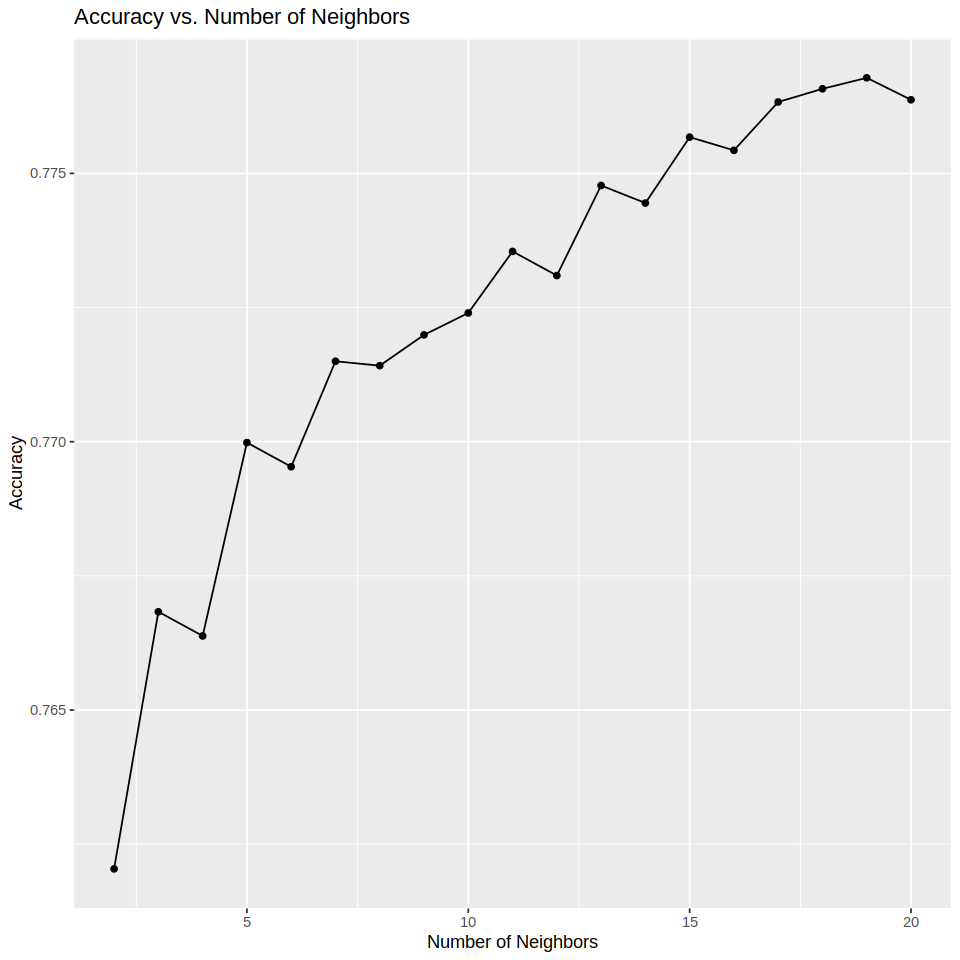

In [12]:
set.seed(9999)
Census_recipe <- recipe(income_lvl ~ ., data = Census_income_train) 

knn_tune <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
            set_engine("kknn") |>
            set_mode("classification")

cv_folds <- vfold_cv(Census_income_train, v = 5, strata = income_lvl)

k_vals <- tibble(neighbors = seq(2,20))

knn_workflow <- workflow() |>
                add_recipe(Census_recipe) |>
                add_model(knn_tune) |>
                tune_grid(resamples = cv_folds,grid = k_vals) |>
                collect_metrics()

accuracies <- knn_workflow |>
              filter(.metric == "accuracy")
head(accuracies)

cross_val_plot <- accuracies |>
                  ggplot(aes(x = neighbors, y = mean)) +
                  geom_point() +
                  geom_line() +
                  labs(title = "Accuracy vs. Number of Neighbors", x = "Number of Neighbors", y = "Accuracy")

cross_val_plot

In [13]:
set.seed(9999)

Census_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = 19) |>
               set_engine("kknn") |>
               set_mode("classification")

Census_fit <- workflow() |>
              add_recipe(Census_recipe) |>
              add_model(Census_spec) |>
              fit(Census_income_train)
Census_fit

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
0 Recipe Steps

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(19,     data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.2208436
Best kernel: rectangular
Best k: 19

In [14]:
set.seed(9999) 

Census_predictions <- predict(Census_fit, Census_income_test) |>
                      bind_cols(Census_income_test)
head(Census_predictions)


Census_metrics <- Census_predictions |>
                  metrics(truth = income_lvl, estimate = .pred_class) |>
                  filter(.metric == "accuracy")
Census_metrics

Census_conf_mat <- Census_predictions |>
                   conf_mat(truth = income_lvl, estimate = .pred_class)
Census_conf_mat

.pred_class,age,education_num,income_lvl
<fct>,<dbl>,<dbl>,<fct>
Less_or_equal_to_50K,39,13,Less_or_equal_to_50K
Less_or_equal_to_50K,50,13,Less_or_equal_to_50K
Less_or_equal_to_50K,38,9,Less_or_equal_to_50K
Less_or_equal_to_50K,28,13,Less_or_equal_to_50K
Less_or_equal_to_50K,40,11,More_than_50K
Less_or_equal_to_50K,38,7,Less_or_equal_to_50K


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.7787741


                      Truth
Prediction             Less_or_equal_to_50K More_than_50K
  Less_or_equal_to_50K                 6092          1713
  More_than_50K                          88           248

### Discussion: 

We believed that our classifier could be useful and helpful in predicting an individual's income levels based on their ages and education numbers, since we got a relatively high accuracy of 77.8%.  Based on our visualization, we have discovered that the optimal K value is K=19 as it provides the most accurate estimation.  Upon analysis of our graphs, we found that individuals with a higher education level have a slightly higher probability of having a yearly income of over 50k. This result makes sense as generally, people who possess higher access education and higher level degrees tend to make more money. Even though our visualization shows that it is more probable for higher education individuals to make more than 50k, we cannot assume that this is the only factor as correlation does not equal causation. There exists many other factors that could influence whether or not an individual makes above/below 50k a year.  We also noticed that there doesn’t seem to be much correlation between age and whether you make above/below 50k a year. This implies that there is no relationship between these two variables as our visualization seems somewhat random. We didn’t really know what to expect for the age variable so you could say our result was expected. 
Our findings could help educational institutions improve their systems as policymakers could use our insights to reform educational policies, focusing on targeted interventions for specific age groups and education levels. Understanding the relationship between education and income could direct the development of programs that aim to improve educational attainment, which could possibly lead to enhanced economic opportunities. Our report could raise some questions such as how do other demographic factors intersect with age and education in influencing income levels? What other factors could possibly influence the type of education every individual receives? 


### References:
Alsulami, Hemaid. “The Effect of Education and Experience on Wages: The Case Study of Saudi Arabia.” American Journal of Industrial and Business Management, vol. 08, no. 01, 2018, pp. 129–142, https://doi.org/10.4236/ajibm.2018.81008.

Chen, Manxue, et al. Literature Review on the Impact of Education on Individual Income. 2nd International Conference on Social Science and Higher Education. 1 Jan. 2016, https://doi.org/10.2991/icsshe-16.2016.118. Accessed 6 Dec. 2023.

Chevalier, Arnaud, et al. “The Impact of Parental Income and Education on the Schooling of Their Children.” IZA Journal of Labor Economics, vol. 2, no. 1, 2013, p. 8, https://doi.org/10.1186/2193-8997-2-8. Accessed 10 Sept. 2019.

Kohavi, Ron. (1996). Census Income. UCI Machine Learning Repository. 
https://doi.org/10.24432/C5GP7S.
